Data Processing.

In [14]:
import pandas as pd
import geopandas as gpd
import requests
import json
from pyproj import Geod
from shapely.geometry import Polygon, LineString, MultiLineString, Point, GeometryCollection
from shapely import wkt
import matplotlib.pyplot as plt
import shapely.geometry
from shapely.ops import unary_union
import seaborn as sns
import numpy as np
from shapely.wkt import loads
from math import radians, cos, sin, sqrt
import re
import folium

In [5]:
#Downloading Trail data from data.ny.gov
df=pd.read_csv("https://data.ny.gov/api/views/7gkb-pzs9/rows.csv?accessType=DOWNLOAD")
df.head()

,the_geom,Unit,Facility,Fac_unq,Name,Alt_Name,Asset,Asset_unq,Colldate,Blaze,...,Horse,Bike,XC,MotorV,Snowmb,Admin,Accessible,Source,Shape_Leng,Abbrev
0,MULTILINESTRING ((-76.70121521885622 43.341418...,Finger Lakes,Fair Haven Beach,NaN,NaN,NaN,Paved Road,0,07/08/2014 07:00:00 AM +0000,NaN,...,N,N,N,N,N,N,N,06,95.063674,NaN
1,MULTILINESTRING ((-76.68861527119671 43.345460...,Finger Lakes,Fair Haven Beach,R044,Bluff Nature Trail,NaN,Marked Trail,0,07/08/2014 07:00:00 AM +0000,NaN,...,N,N,N,N,N,N,N,06,161.206587,NaN
2,MULTILINESTRING ((-76.6872846758241 43.3461331...,Finger Lakes,Fair Haven Beach,R044,Bluff Nature Trail,NaN,Marked Trail,0,07/08/2014 07:00:00 AM +0000,NaN,...,N,N,N,N,N,N,N,06,386.111999,NaN
3,MULTILINESTRING ((-76.68532937548815 43.348559...,Finger Lakes,Fair Haven Beach,R044,Bluff Nature Trail,NaN,Marked Trail,0,07/08/2014 07:00:00 AM +0000,NaN,...,N,N,N,N,N,N,N,06,29.206690,NaN
4,MULTILINESTRING ((-76.68548046772699 43.348797...,Finger Lakes,Fair Haven Beach,R044,Bluff Nature Trail,NaN,Marked Trail,0,07/08/2014 07:00:00 AM +0000,NaN,...,N,N,N,N,N,N,N,06,176.328667,NaN


In [6]:
# convert the 'multiline' column to shapely geometry objects
df['the_geom'] = df['the_geom'].apply(lambda x: loads(x))
gdf = gpd.GeoDataFrame(df,  geometry='the_geom', crs='EPSG:4326')
gdf.rename(columns ={'the_geom':'geometry'}, inplace=True)

In [8]:
gdf.Name.value_counts()

Unnamed                 625
Unmarked Trail          149
Connector               136
Bridle Path             121
Park Road               120
                       ... 
LLRBC                     1
Mc Keags Meadow Conn      1
Zeus Trail                1
Firing Range Road         1
Water Line                1
Name: Name, Length: 1149, dtype: int64

In [9]:
#Correcting missing data
gdf["Bike"].fillna(method="ffill", inplace=True)
gdf["Snowmb"].fillna(method="ffill", inplace=True)
gdf["Foot"].fillna(method="ffill", inplace=True)
gdf["Horse"].fillna(method="ffill", inplace=True)
gdf["Accessible"].fillna(method="ffill", inplace=True)
gdf["Snowmb"].fillna(method="ffill", inplace=True)
gdf["Facility"].fillna(method="ffill", inplace=True)
gdf['Foot'].replace(['y', 'I', '-99', 'U'], 'Y', inplace=True)
gdf['Bike'].replace(['N`', 'n', 'U', 'I', 'y'], ['N','N','N','Y', 'Y'], inplace=True)
gdf['Horse'].replace(['n', 'U', 'y', 'I'], ['N', 'N', 'Y', 'Y'], inplace=True)
gdf['Snowmb'].replace(['n'], ['N'], inplace=True)
gdf['Accessible'].replace(['y', 'n'], ['Y', 'N'], inplace=True)
gdf['Condition'].replace(['good', 'GOod','fair', 'poor'], ['Good', 'Good', 'Fair', 'Poor'], inplace=True)
gdf.Accessible.unique()
#df.Foot.value_counts()
gdf.head()

,geometry,Unit,Facility,Fac_unq,Name,Alt_Name,Asset,Asset_unq,Colldate,Blaze,...,Horse,Bike,XC,MotorV,Snowmb,Admin,Accessible,Source,Shape_Leng,Abbrev
0,"MULTILINESTRING ((-76.70122 43.34142, -76.7012...",Finger Lakes,Fair Haven Beach,NaN,NaN,NaN,Paved Road,0,07/08/2014 07:00:00 AM +0000,NaN,...,N,N,N,N,N,N,N,06,95.063674,NaN
1,"MULTILINESTRING ((-76.68862 43.34546, -76.6884...",Finger Lakes,Fair Haven Beach,R044,Bluff Nature Trail,NaN,Marked Trail,0,07/08/2014 07:00:00 AM +0000,NaN,...,N,N,N,N,N,N,N,06,161.206587,NaN
2,"MULTILINESTRING ((-76.68728 43.34613, -76.6872...",Finger Lakes,Fair Haven Beach,R044,Bluff Nature Trail,NaN,Marked Trail,0,07/08/2014 07:00:00 AM +0000,NaN,...,N,N,N,N,N,N,N,06,386.111999,NaN
3,"MULTILINESTRING ((-76.68533 43.34856, -76.6854...",Finger Lakes,Fair Haven Beach,R044,Bluff Nature Trail,NaN,Marked Trail,0,07/08/2014 07:00:00 AM +0000,NaN,...,N,N,N,N,N,N,N,06,29.206690,NaN
4,"MULTILINESTRING ((-76.68548 43.34880, -76.6855...",Finger Lakes,Fair Haven Beach,R044,Bluff Nature Trail,NaN,Marked Trail,0,07/08/2014 07:00:00 AM +0000,NaN,...,N,N,N,N,N,N,N,06,176.328667,NaN


In [10]:
#Filtering out the relevant columns
gdf_filtered=gdf[['geometry', 'Unit', 'Facility', 'Name', 'Asset', 'Foot', 'Horse', 'Bike', 'Snowmb', 'Accessible', 'Shape_Leng']].copy()

In [11]:
gdf_filtered.isna().sum()

geometry         0
Unit             0
Facility         0
Name          1499
Asset            0
Foot             0
Horse            0
Bike             0
Snowmb           0
Accessible       0
Shape_Leng       0
dtype: int64

In [12]:
#creating an index column
gdf_filtered.reset_index(inplace=True)

In [13]:
#Naming all the missing trail names 
gdf_filtered.loc[gdf_filtered['Name'].isna(), 'Name'] = 'Missing Trail Name'

In [19]:
#Grouping the segmented trails over the 'group_cols'
group_cols = ['Unit', 'Facility', 'Name', 'Asset', 'Foot', 'Horse', 'Bike', 'Snowmb', 'Accessible']
gdf_grouped = gdf_filtered.groupby(group_cols, as_index=False).agg({'geometry': unary_union, 'Shape_Leng': 'sum'})
gdf_grouped.set_geometry("geometry", inplace=True)
# Convert to WGS84 CRS
gdf_grouped.set_crs(epsg=4326, inplace=True)
gdf_grouped.head()

,Unit,Facility,Name,Asset,Foot,Horse,Bike,Snowmb,Accessible,geometry,Shape_Leng
0,Allegany,Allegany,ASP 1,Paved Road,Y,Y,N,Y,N,"MULTILINESTRING ((-78.78111 42.04172, -78.7810...",2762.553239
1,Allegany,Allegany,ASP1,Paved Road,Y,N,Y,Y,N,"MULTILINESTRING ((-78.82620 42.01107, -78.8261...",11247.667588
2,Allegany,Allegany,Bay State Rd,Paved Road,Y,Y,N,N,N,"MULTILINESTRING ((-78.80375 42.08613, -78.8039...",1599.398857
3,Allegany,Allegany,Bay State Rd,Paved Road,Y,Y,N,Y,N,"LINESTRING (-78.79718 42.08226, -78.79780 42.0...",722.157056
4,Allegany,Allegany,Bay State Rd,Unpaved Road,Y,Y,N,Y,N,"LINESTRING (-78.80453 42.08277, -78.80502 42.0...",5830.772003


In [20]:
# Map the data (Data Visualization)
from folium.plugins import MarkerCluster
from folium.features import GeoJson, GeoJsonTooltip

# Create the map
m = folium.Map(location=[gdf_grouped.geometry.centroid.y.mean(), gdf_grouped.geometry.centroid.x.mean()], zoom_start=7, tiles='CartoDBPositron')

# Add the trail lines as a separate layer
geojson = GeoJson(gdf_grouped, style_function=lambda feature: {'color': '#e31a1c', 'weight': 2})
geojson.add_to(m)

# Add trail name popups
for idx, row in gdf_grouped.iterrows():
    location = [row.geometry.centroid.y, row.geometry.centroid.x]
    popup_text = f"Trail Name: {row.Name}<br>Length: {round(row.Shape_Leng, 2)} meters"
    popup = folium.Popup(popup_text, max_width=200)
    folium.Marker(location=location, popup=popup).add_to(m)

# Show the map
m

/var/folders/dz/j5wssbrn5m11y98nkbpt60kr0000gn/T/ipykernel_9454/3324780915.py:6: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  m = folium.Map(location=[gdf_grouped.geometry.centroid.y.mean(), gdf_grouped.geometry.centroid.x.mean()], zoom_start=7, tiles='CartoDBPositron')
/var/folders/dz/j5wssbrn5m11y98nkbpt60kr0000gn/T/ipykernel_9454/3324780915.py:6: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  m = folium.Map(location=[gdf_grouped.geometry.centroid.y.mean(), gdf_grouped.geometry.centroid.x.mean()], zoom_start=7, tiles='CartoDBPositron')


<Axes: xlabel='Snowmb', ylabel='Count'>

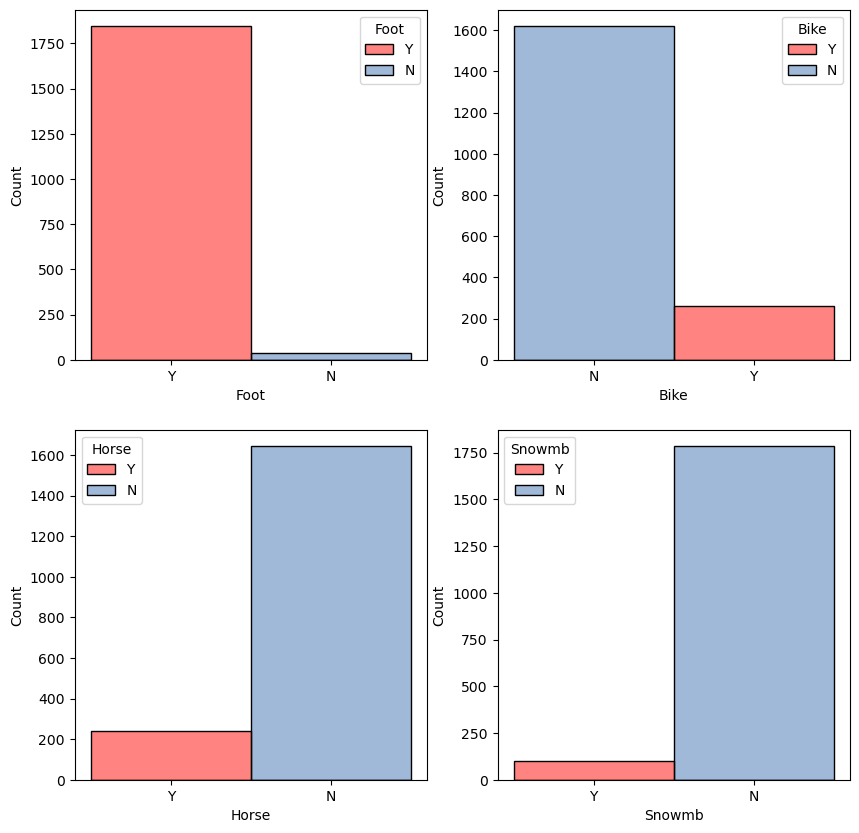

In [22]:
fig, axs = plt.subplots(2, 2, figsize=(10, 10))
colors = ["#FF0B04", "#4374B3"]
sns.set_palette(sns.color_palette(colors))
sns.histplot(data=gdf_grouped, x='Foot', color="Purple", hue='Foot', hue_order=["Y", "N"], kde=True, ax=axs[0, 0])
sns.histplot(data=gdf_grouped, x='Bike', color="skyblue", hue='Bike', hue_order=["Y", "N"], kde=True, ax=axs[0, 1])
sns.histplot(data=gdf_grouped, x='Horse', color="red", hue='Horse', hue_order=["Y", "N"], kde=True, ax=axs[1, 0])
sns.histplot(data=gdf_grouped, x='Snowmb', color="yellow", hue='Snowmb', hue_order=["Y", "N"], kde=True, ax=axs[1, 1])

<Axes: xlabel='Asset', ylabel='Count'>

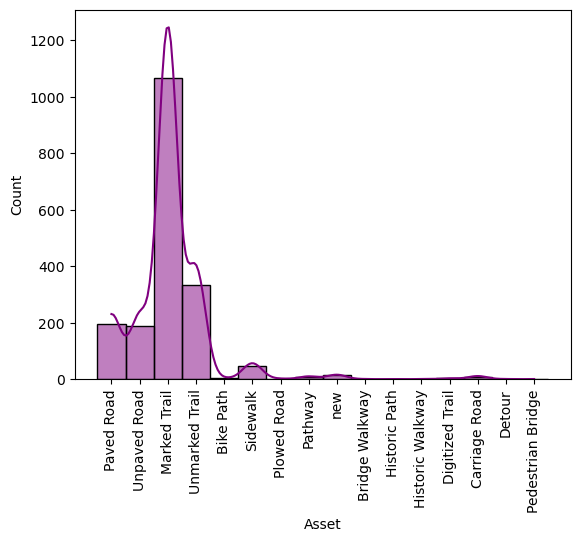

In [23]:
#The type of trail paths
plt.xticks(rotation=90)
sns.histplot(data=gdf_grouped, x='Asset', color="Purple", label="Sepal Length", kde=True)